In [2]:
#load libraries
import pandas as pd
import numpy as np
import seaborn as sns
import time
import random
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.figure_factory as ff
from iso639 import languages
import user_agents
from ip2geotools.databases.noncommercial import DbIpCity as ip2geo
import requests
import json
from geopy.distance import great_circle
from geopy.geocoders import Nominatim
from datasist.structdata import detect_outliers
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from sklearn.preprocessing import OneHotEncoder
import category_encoders as ce
from datetime import datetime
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import RandomOverSampler 
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler

%matplotlib inline


# Questions

- Profit = cash - taxes (0.14)
- Analyize all sales profit
- What is the profit for each weekday
- What is the profit from each city

In [82]:
#load data
df=pd.read_csv('Sales.csv')
df.head()

,Order ID,Product,Quantity Ordered,Price Each,Order Date,Purchase Address
0,295665,Macbook Pro Laptop,1,1700$,12/30/19 00:01,"136 Church St, New York City, NY 10001"
1,295666,LG Washing Machine,1,600.0$,12/29/19 07:03,"562 2nd St, New York City, NY 10001"
2,295667,USB-C Charging Cable,1,11.95$,12/12/19 18:21,"277 Main St, New York City, NY 10001"
3,295668,27in FHD Monitor,1,149.99$,12/22/19 15:13,"410 6th St, San Francisco, CA 94016"
4,295669,USB-C Charging Cable,1,11.95$,12/18/19 12:38,"43 Hill St, Atlanta, GA 30301"


## 1. Distniguesh features

In [83]:
#summarize data
def dataset_shape():
    print("head : \n",df.head() )
    print("shape : \n",df.shape )
    print("describe : \n",df.describe() )
    print("describe categories \n: ",df.describe(include='O') )
    print("types : \n",df.dtypes )
    print("null columns : \n",df.isnull().sum() )
    print("duplicated rows: \n",df.duplicated().sum() )
    print("info : \n",df.info() )
dataset_shape()    

head : 
   Order ID               Product Quantity Ordered Price Each      Order Date  \
0   295665    Macbook Pro Laptop                1      1700$  12/30/19 00:01   
1   295666    LG Washing Machine                1     600.0$  12/29/19 07:03   
2   295667  USB-C Charging Cable                1     11.95$  12/12/19 18:21   
3   295668      27in FHD Monitor                1    149.99$  12/22/19 15:13   
4   295669  USB-C Charging Cable                1     11.95$  12/18/19 12:38   

                         Purchase Address  
0  136 Church St, New York City, NY 10001  
1     562 2nd St, New York City, NY 10001  
2    277 Main St, New York City, NY 10001  
3     410 6th St, San Francisco, CA 94016  
4           43 Hill St, Atlanta, GA 30301  
shape : 
 (25117, 6)
describe : 
         Order ID               Product Quantity Ordered Price Each  \
count      25037                 25037            25037      25117   
unique     24007                    20                8         20   
to

## 2. Data cleaning

**Problems**

- Numerical
    - Quantity Ordered is not numerical
    - Price Each not numerical
- Categorical
    - Product columns has 'Product' value 

In [84]:
df.isna().sum()
df.isna().mean() * 100
df.isna().sum()/len(df) * 100
df.isna().sum()/df.shape[0] * 100

Order ID            0.318509
Product             0.318509
Quantity Ordered    0.318509
Price Each          0.000000
Order Date          0.318509
Purchase Address    0.318509
dtype: float64

In [85]:
df.columns=df.columns.str.lower().str.strip()
df.columns=df.columns.str.replace(' ','_')
df.columns

Index(['order_id', 'product', 'quantity_ordered', 'price_each', 'order_date',
       'purchase_address'],
      dtype='object')

In [86]:
#the percentage of null values for each column
def missing_values(n):
    df_null=pd.DataFrame()
    df_null['% of missing values']=n.isna().sum()/len(df) * 100
    df_null['sum of missing values']=n.isna().sum()
    return df_null.sort_values(by='% of missing values',ascending=False)
missing_values(df)

,% of missing values,sum of missing values
order_id,0.318509,80
product,0.318509,80
quantity_ordered,0.318509,80
order_date,0.318509,80
purchase_address,0.318509,80
price_each,0.000000,0


In [71]:
#univaraite analysis
#for numerical data
lst=[]
for i in df.columns:
    if df[i].dtypes == 'int64' or df[i].dtypes == 'float64' :
        lst.append(i)
print("histograms for Numerical features \n")
#for i in list
for i in range(len(lst)):
    print(f"for feature {lst[i]} : \n",df[lst[i]].value_counts())
    fig=px.histogram(df,x=lst[i],title=f'for feature {lst[i]} ',color_discrete_sequence=['green'],marginal='box',text_auto=True)
    fig.show()
    print()
    print("------------------------")
print("####################################################################################")   
#for categorical data
lst=[]
for i in df.columns:
    if df[i].dtypes == 'object' :
        lst.append(i)
print("violins for categorical features \n")
for i in range(len(lst)):
    print(f"for feature {lst[i]} : \n",df[lst[i]].value_counts())
    fig=px.violin(df,x=lst[i],title=f'for feature {lst[i]} ',color_discrete_sequence=['pink'])
    fig.show()
    print()
    print("------------------------")

histograms for Numerical features 

####################################################################################
violins for categorical features 

for feature order_id : 
 Order ID    48
312462       4
304802       4
296353       4
312407       4
            ..
303833       1
303832       1
303831       1
303830       1
319670       1
Name: order_id, Length: 24007, dtype: int64



------------------------
for feature product : 
 USB-C Charging Cable          2981
Lightning Charging Cable      2894
AAA Batteries (4-pack)        2831
AA Batteries (4-pack)         2717
Wired Headphones              2542
Apple Airpods Headphones      2059
Bose SoundSport Headphones    1808
27in FHD Monitor               962
iPhone                         908
27in 4K Gaming Monitor         860
34in Ultrawide Monitor         846
Google Phone                   715
Flatscreen TV                  662
Macbook Pro Laptop             644
20in Monitor                   568
ThinkPad Laptop                541
Vareebadd Phone                285
LG Dryer                        86
LG Washing Machine              80
Product                         48
Name: product, dtype: int64



------------------------
for feature quantity_ordered : 
 1                   22641
2                    1793
3                     397
4                     109
Quantity Ordered       48
5                      30
6                      16
7                       3
Name: quantity_ordered, dtype: int64



------------------------
for feature price_each : 
 11.95$         2981
14.95$         2894
2.99$          2831
3.84$          2717
11.99$         2542
150$           2059
99.99$         1808
149.99$         962
700$            908
389.99$         860
379.99$         846
600$            715
300$            662
1700$           644
109.99$         568
999.99$         541
400$            285
600.0$          166
nan$             80
Price Each$      48
Name: price_each, dtype: int64



------------------------
for feature order_date : 
 Order Date        48
12/15/19 20:16     8
12/11/19 13:24     7
12/04/19 13:42     6
12/13/19 11:57     6
                  ..
12/13/19 11:35     1
12/09/19 21:21     1
12/03/19 21:02     1
12/12/19 21:14     1
12/03/19 10:39     1
Name: order_date, Length: 17306, dtype: int64



------------------------
for feature purchase_address : 
 Purchase Address                           48
146 5th St, San Francisco, CA 94016         5
594 6th St, San Francisco, CA 94016         4
249 5th St, San Francisco, CA 94016         4
210 Spruce St, San Francisco, CA 94016      4
                                           ..
664 Dogwood St, San Francisco, CA 94016     1
972 Forest St, Seattle, WA 98101            1
68 Walnut St, Portland, OR 97035            1
653 Elm St, Los Angeles, CA 90001           1
747 Chestnut St, Los Angeles, CA 90001      1
Name: purchase_address, Length: 23215, dtype: int64



------------------------


In [72]:
#bivaraite analysis
lst=list(df.columns)
#lst=df.columns.to_list()
for i in range(len(lst)):
    for j in range(i+1,len(lst)):
        fig=px.scatter(df,x=lst[i],y=lst[j],color_discrete_sequence=['pink'],title=f'for feature {lst[i]} vs feature {lst[j]} ')
        fig.show() 

In [90]:
#domain knowledge feature
df
#string operation
def fix_price(x):
    try :
        return float(x.split('$')[0])
    except :
        return np.nan
df['price_each']=df['price_each'].apply(fix_price)
df



,order_id,product,quantity_ordered,price_each,order_date,purchase_address
0,295665,Macbook Pro Laptop,1,1700.00,12/30/19 00:01,"136 Church St, New York City, NY 10001"
1,295666,LG Washing Machine,1,600.00,12/29/19 07:03,"562 2nd St, New York City, NY 10001"
2,295667,USB-C Charging Cable,1,11.95,12/12/19 18:21,"277 Main St, New York City, NY 10001"
3,295668,27in FHD Monitor,1,149.99,12/22/19 15:13,"410 6th St, San Francisco, CA 94016"
4,295669,USB-C Charging Cable,1,11.95,12/18/19 12:38,"43 Hill St, Atlanta, GA 30301"
...,...,...,...,...,...,...
25112,319666,Lightning Charging Cable,1,14.95,12/11/19 20:58,"14 Madison St, San Francisco, CA 94016"
25113,319667,AA Batteries (4-pack),2,3.84,12/01/19 12:01,"549 Willow St, Los Angeles, CA 90001"
25114,319668,Vareebadd Phone,1,400.00,12/09/19 06:43,"273 Wilson St, Seattle, WA 98101"
25115,319669,Wired Headphones,1,11.99,12/03/19 10:39,"778 River St, Dallas, TX 75001"


In [91]:
#date and time feature
df['order_date']=pd.to_datetime(df['order_date'],format='%m/%d/%y %H:%M',errors='coerce')
df['order_date_year']=df['order_date'].dt.year
df['order_date_month']=df['order_date'].dt.month
df['order_date_day']=df['order_date'].dt.day
df['order_date_day_name']=df['order_date'].dt.day_name()
df['order_date_hour']=df['order_date'].dt.hour
df['order_date_minute']=df['order_date'].dt.minute
df

,order_id,product,quantity_ordered,price_each,order_date,purchase_address,order_date_year,order_date_month,order_date_day,order_date_day_name,order_date_hour,order_date_minute
0,295665,Macbook Pro Laptop,1,1700.00,2019-12-30 00:01:00,"136 Church St, New York City, NY 10001",2019.0,12.0,30.0,Monday,0.0,1.0
1,295666,LG Washing Machine,1,600.00,2019-12-29 07:03:00,"562 2nd St, New York City, NY 10001",2019.0,12.0,29.0,Sunday,7.0,3.0
2,295667,USB-C Charging Cable,1,11.95,2019-12-12 18:21:00,"277 Main St, New York City, NY 10001",2019.0,12.0,12.0,Thursday,18.0,21.0
3,295668,27in FHD Monitor,1,149.99,2019-12-22 15:13:00,"410 6th St, San Francisco, CA 94016",2019.0,12.0,22.0,Sunday,15.0,13.0
4,295669,USB-C Charging Cable,1,11.95,2019-12-18 12:38:00,"43 Hill St, Atlanta, GA 30301",2019.0,12.0,18.0,Wednesday,12.0,38.0
...,...,...,...,...,...,...,...,...,...,...,...,...
25112,319666,Lightning Charging Cable,1,14.95,2019-12-11 20:58:00,"14 Madison St, San Francisco, CA 94016",2019.0,12.0,11.0,Wednesday,20.0,58.0
25113,319667,AA Batteries (4-pack),2,3.84,2019-12-01 12:01:00,"549 Willow St, Los Angeles, CA 90001",2019.0,12.0,1.0,Sunday,12.0,1.0
25114,319668,Vareebadd Phone,1,400.00,2019-12-09 06:43:00,"273 Wilson St, Seattle, WA 98101",2019.0,12.0,9.0,Monday,6.0,43.0
25115,319669,Wired Headphones,1,11.99,2019-12-03 10:39:00,"778 River St, Dallas, TX 75001",2019.0,12.0,3.0,Tuesday,10.0,39.0


In [ ]:
#web data
#no web data except the user agent i have passed when scrapping
#geo 
#no geo data

In [92]:
#fature transforamtion
#cleansing
#clean columns
df.dtypes

order_id                       object
product                        object
quantity_ordered               object
price_each                    float64
order_date             datetime64[ns]
purchase_address               object
order_date_year               float64
order_date_month              float64
order_date_day                float64
order_date_day_name            object
order_date_hour               float64
order_date_minute             float64
dtype: object

In [93]:
lst=['order_id','quantity_ordered','order_date_year','order_date_month','order_date_day','order_date_hour','order_date_minute']
def convert_int(x):
    try:
        return int(x)
    except:
        np.nan
for i in lst :
    df[i]=df[i].apply(convert_int)
df.dtypes    

order_id                      float64
product                        object
quantity_ordered              float64
price_each                    float64
order_date             datetime64[ns]
purchase_address               object
order_date_year               float64
order_date_month              float64
order_date_day                float64
order_date_day_name            object
order_date_hour               float64
order_date_minute             float64
dtype: object

In [94]:
#clean rows
df[df['order_id'] <= 0]
for p in df['product'].unique():
    print(p)
x=df[df['product'] == 'Product'].index
x

Macbook Pro Laptop
LG Washing Machine
USB-C Charging Cable
27in FHD Monitor
AA Batteries (4-pack)
Bose SoundSport Headphones
AAA Batteries (4-pack)
ThinkPad Laptop
Lightning Charging Cable
Google Phone
Wired Headphones
Apple Airpods Headphones
Vareebadd Phone
iPhone
20in Monitor
34in Ultrawide Monitor
Flatscreen TV
27in 4K Gaming Monitor
Product
nan
LG Dryer


Int64Index([  254,   705,  1101,  2875,  3708,  3793,  3812,  4218,  5143,
             5293,  6608,  6752,  7367,  7704,  7781,  8094, 10417, 11522,
            11545, 11616, 12336, 12516, 12673, 13161, 16573, 16787, 17012,
            17085, 18648, 19074, 19326, 19478, 19580, 19709, 20041, 20318,
            20398, 20549, 20986, 21148, 21549, 22054, 22375, 23198, 23337,
            23748, 24192, 24222],
           dtype='int64')

# Missing Values

In [95]:
df.drop(x,axis=0,inplace=True)
for p in df['product'].unique():
    print(p)

Macbook Pro Laptop
LG Washing Machine
USB-C Charging Cable
27in FHD Monitor
AA Batteries (4-pack)
Bose SoundSport Headphones
AAA Batteries (4-pack)
ThinkPad Laptop
Lightning Charging Cable
Google Phone
Wired Headphones
Apple Airpods Headphones
Vareebadd Phone
iPhone
20in Monitor
34in Ultrawide Monitor
Flatscreen TV
27in 4K Gaming Monitor
nan
LG Dryer


In [96]:
df.dtypes

order_id                      float64
product                        object
quantity_ordered              float64
price_each                    float64
order_date             datetime64[ns]
purchase_address               object
order_date_year               float64
order_date_month              float64
order_date_day                float64
order_date_day_name            object
order_date_hour               float64
order_date_minute             float64
dtype: object

In [97]:
df[df['quantity_ordered']<=0]
df[df['price_each']<=0]
df[df['order_date_day'] <= 0]
df[df['order_date_day'] > 31]
df[df['order_date_month'] <= 0]
df[df['order_date_month'] > 12]
df[df['order_date_year'] > 2020]
df[df['order_date_hour'] < 0]
df[df['order_date_hour'] > 24]
df[df['order_date_minute'] < 0]
df[df['order_date_minute'] > 60]

,order_id,product,quantity_ordered,price_each,order_date,purchase_address,order_date_year,order_date_month,order_date_day,order_date_day_name,order_date_hour,order_date_minute


In [99]:
#work with missing data
df.isna().sum()

order_id               80
product                80
quantity_ordered       80
price_each             80
order_date             80
purchase_address       80
order_date_year        80
order_date_month       80
order_date_day         80
order_date_day_name    80
order_date_hour        80
order_date_minute      80
dtype: int64

In [101]:
#work with missing data
df.isnull().sum()
df.dropna(axis=0,inplace=True)
df.isna().sum()

order_id               0
product                0
quantity_ordered       0
price_each             0
order_date             0
purchase_address       0
order_date_year        0
order_date_month       0
order_date_day         0
order_date_day_name    0
order_date_hour        0
order_date_minute      0
dtype: int64

# Handle Duplicated values

In [103]:
#detect and handle duplicated values
#detect
df[df.duplicated()]

,order_id,product,quantity_ordered,price_each,order_date,purchase_address,order_date_year,order_date_month,order_date_day,order_date_day_name,order_date_hour,order_date_minute
440,296081.0,Flatscreen TV,1.0,300.00,2019-12-30 16:52:00,"970 Sunset St, Austin, TX 73301",2019.0,12.0,30.0,Monday,16.0,52.0
1735,297311.0,Bose SoundSport Headphones,1.0,99.99,2019-12-07 07:30:00,"858 Willow St, Los Angeles, CA 90001",2019.0,12.0,7.0,Saturday,7.0,30.0
2822,298358.0,Apple Airpods Headphones,1.0,150.00,2019-12-04 15:57:00,"482 8th St, San Francisco, CA 94016",2019.0,12.0,4.0,Wednesday,15.0,57.0
3131,298657.0,Lightning Charging Cable,1.0,14.95,2019-12-01 18:22:00,"428 12th St, Atlanta, GA 30301",2019.0,12.0,1.0,Sunday,18.0,22.0
3377,298883.0,Wired Headphones,1.0,11.99,2019-12-28 18:07:00,"516 Willow St, Los Angeles, CA 90001",2019.0,12.0,28.0,Saturday,18.0,7.0
3486,298988.0,Wired Headphones,1.0,11.99,2019-12-26 16:11:00,"528 8th St, Austin, TX 73301",2019.0,12.0,26.0,Thursday,16.0,11.0
4650,300085.0,AA Batteries (4-pack),1.0,3.84,2019-12-17 14:01:00,"601 Spruce St, Boston, MA 02215",2019.0,12.0,17.0,Tuesday,14.0,1.0
4686,300119.0,Wired Headphones,1.0,11.99,2019-12-30 13:22:00,"533 Jackson St, Seattle, WA 98101",2019.0,12.0,30.0,Monday,13.0,22.0
4696,300127.0,Wired Headphones,1.0,11.99,2019-12-10 08:55:00,"385 Center St, Dallas, TX 75001",2019.0,12.0,10.0,Tuesday,8.0,55.0
6320,301693.0,AAA Batteries (4-pack),1.0,2.99,2019-12-20 16:44:00,"536 Spruce St, San Francisco, CA 94016",2019.0,12.0,20.0,Friday,16.0,44.0


In [105]:
df.drop_duplicates(inplace=True,reset_index=True)
df.duplicated().sum()

0

# Handle Outliers

['order_id', 'quantity_ordered', 'price_each', 'order_date_year', 'order_date_month', 'order_date_day', 'order_date_hour', 'order_date_minute']
detect outliers
---------------------------------------------


<AxesSubplot:xlabel='price_each'>

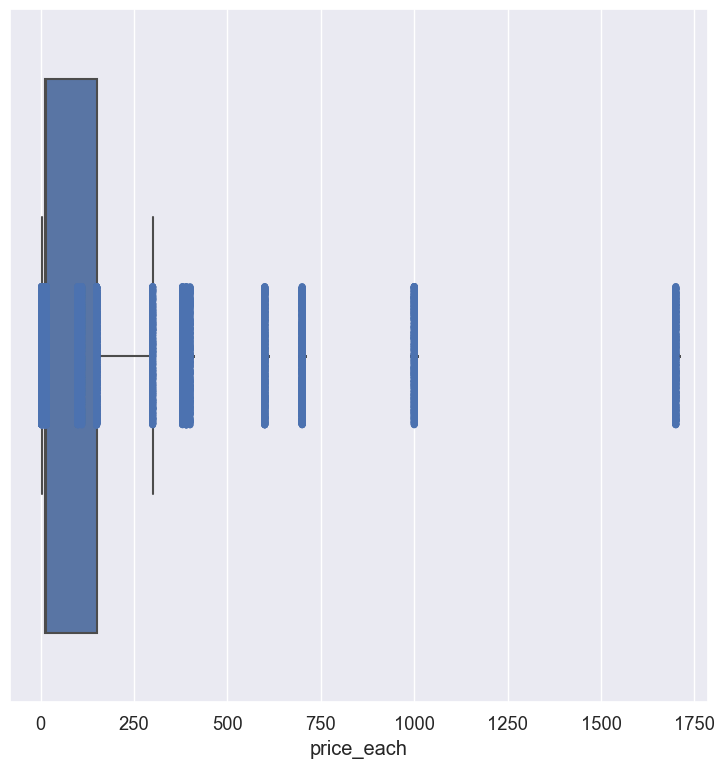

In [111]:
#detect and handle outliers
#detect
lst=[]
for i in df.columns:
    if df[i].dtypes == 'int64' or df[i].dtypes == 'float64' :
        lst.append(i)
print(lst)
sns.set(rc={'figure.figsize': [9, 9]}, font_scale=1.2)
print("detect outliers")
print("---------------------------------------------")
sns.boxplot(data=df,x='price_each')
sns.stripplot(data=df,x='price_each')

In [112]:
lst

['order_id',
 'quantity_ordered',
 'price_each',
 'order_date_year',
 'order_date_month',
 'order_date_day',
 'order_date_hour',
 'order_date_minute']

In [117]:
#handle
x=detect_outliers(df, 0, ['price_each', 'quantity_ordered'])
x
df.loc[x]
df.drop(x,axis=0,inplace=True)

In [118]:
lst=['order_id','price_each','quantity_ordered','order_date_year','order_date_month','order_date_day','order_date_hour','order_date_minute']
def convert_int(x):

    return int(x)
    
for i in lst :
    df[i]=df[i].apply(convert_int)
df.dtypes    

order_id                        int64
product                        object
quantity_ordered                int64
price_each                      int64
order_date             datetime64[ns]
purchase_address               object
order_date_year                 int64
order_date_month                int64
order_date_day                  int64
order_date_day_name            object
order_date_hour                 int64
order_date_minute               int64
dtype: object

# Feature Engineering

### Profit
Profit = cash - taxes (0.14)

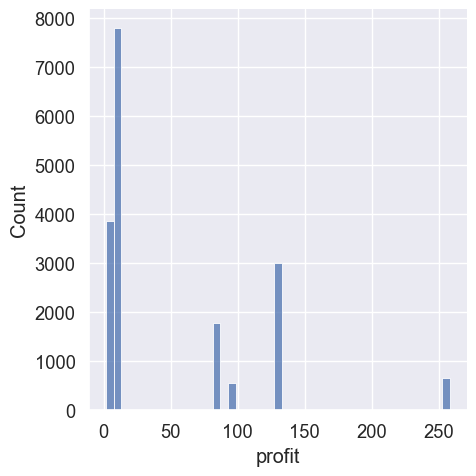

In [126]:
#bussiness insights
#feature engineering
def get_profit(x):
    cash=x['quantity_ordered']*x['price_each']
    taxes=cash * 0.14
    profit=cash-taxes
    return profit
df['profit']=df.apply(get_profit,axis=1)
df
fig=px.histogram(df,x='profit',text_auto=True,title='profit',color_discrete_sequence=['blue'])
fig.update_layout(title_x=0.5)
fig.show()
sns.displot(data=df,x='profit')

In [124]:
#profit for each city
def get_city(x):
    return x.split(', ')[1]
df['city']=df['purchase_address'].apply(get_city)
#df['city']=df['purchase_address'].apply(lambda x : x.split(', ')[1])
df

,order_id,product,quantity_ordered,price_each,order_date,purchase_address,order_date_year,order_date_month,order_date_day,order_date_day_name,order_date_hour,order_date_minute,profit,city
2,295667,USB-C Charging Cable,1,11,2019-12-12 18:21:00,"277 Main St, New York City, NY 10001",2019,12,12,Thursday,18,21,9.46,New York City
3,295668,27in FHD Monitor,1,149,2019-12-22 15:13:00,"410 6th St, San Francisco, CA 94016",2019,12,22,Sunday,15,13,128.14,San Francisco
4,295669,USB-C Charging Cable,1,11,2019-12-18 12:38:00,"43 Hill St, Atlanta, GA 30301",2019,12,18,Wednesday,12,38,9.46,Atlanta
5,295670,AA Batteries (4-pack),1,3,2019-12-31 22:58:00,"200 Jefferson St, New York City, NY 10001",2019,12,31,Tuesday,22,58,2.58,New York City
6,295671,USB-C Charging Cable,1,11,2019-12-16 15:10:00,"928 12th St, Portland, OR 97035",2019,12,16,Monday,15,10,9.46,Portland
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25108,319662,Bose SoundSport Headphones,1,99,2019-12-31 19:07:00,"939 8th St, San Francisco, CA 94016",2019,12,31,Tuesday,19,7,85.14,San Francisco
25109,319663,Flatscreen TV,1,300,2019-12-07 08:25:00,"334 12th St, Atlanta, GA 30301",2019,12,7,Saturday,8,25,258.00,Atlanta
25112,319666,Lightning Charging Cable,1,14,2019-12-11 20:58:00,"14 Madison St, San Francisco, CA 94016",2019,12,11,Wednesday,20,58,12.04,San Francisco
25115,319669,Wired Headphones,1,11,2019-12-03 10:39:00,"778 River St, Dallas, TX 75001",2019,12,3,Tuesday,10,39,9.46,Dallas


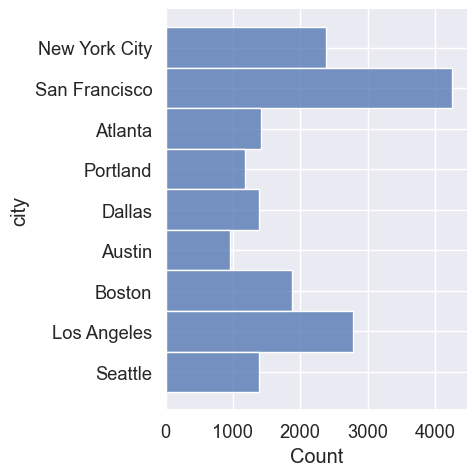

In [128]:
fig=px.histogram(df,x='city',text_auto=True,title='city',color_discrete_sequence=['blue'])
fig.update_layout(title_x=0.5)
fig.show()
sns.displot(data=df,y='city')

In [131]:
x=df.groupby('city')[['profit']].sum().sort_values(by='profit',ascending=False)
x

,profit
city,
San Francisco,203456.22
Los Angeles,133042.00
New York City,114754.96
Boston,90748.06
Dallas,69180.12
Seattle,67222.76
Atlanta,66348.14
Portland,57152.16
Austin,47077.26


In [140]:
df_city=df[df['city'].isin(x.index)]
df_city
#fig=px.histogram(x,x=x.index,y=x,title='city vs profit')
fig=px.histogram(df_city,x='city',y='profit',title='city vs profit')
fig.update_layout(title_x=0.5)
fig.show()

<AxesSubplot:xlabel='profit', ylabel='city'>

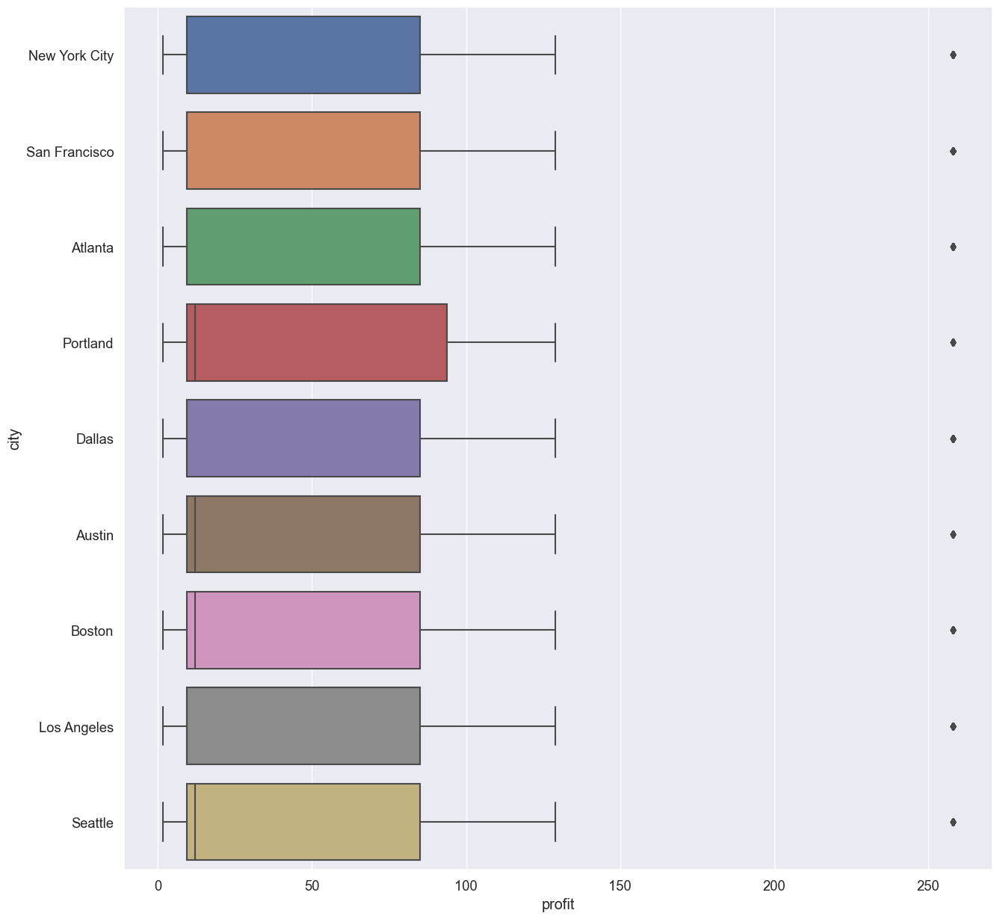

In [149]:
sns.set(rc={'figure.figsize': [15, 15]}, font_scale=1.2)
sns.boxplot(data=df_city,y='city',x='profit')

<AxesSubplot:xlabel='profit', ylabel='city'>

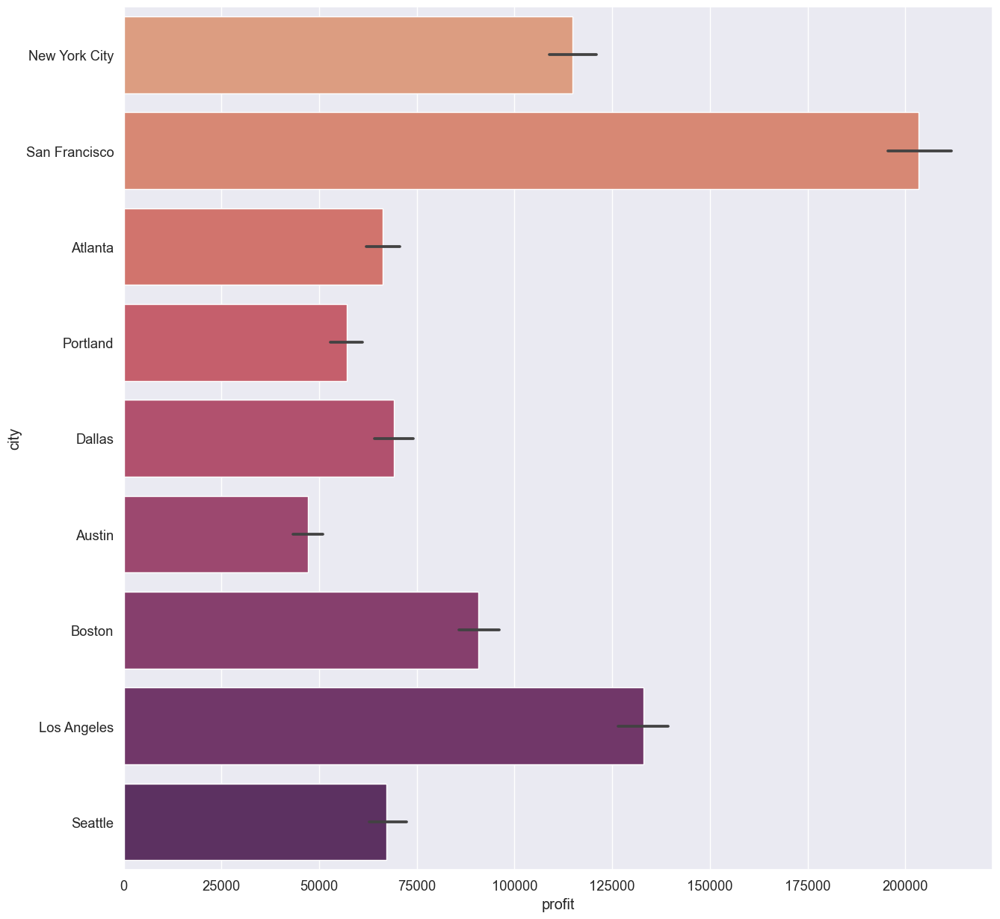

In [151]:
sns.barplot(data=df_city,y='city',x='profit',estimator=np.sum,palette='flare')

In [153]:
x=df.groupby('order_date_day_name')[['profit']].sum().sort_values(by='profit',ascending=False)
x

,profit
order_date_day_name,
Monday,136660.88
Sunday,132237.04
Tuesday,130836.96
Wednesday,117809.68
Friday,112918.00
Saturday,109871.88
Thursday,108647.24


In [157]:
df_profit=df[df['order_date_day_name'].isin(x.index)]
#fig=px.histogram(x,x=x.index,y=x or y='profit' ,title='city vs profit')
fig=px.histogram(df_profit,x='order_date_day_name',y='profit',title='weekday vs profit')
fig.update_layout(title_x=0.5)
fig.show()

<AxesSubplot:xlabel='profit', ylabel='order_date_day_name'>

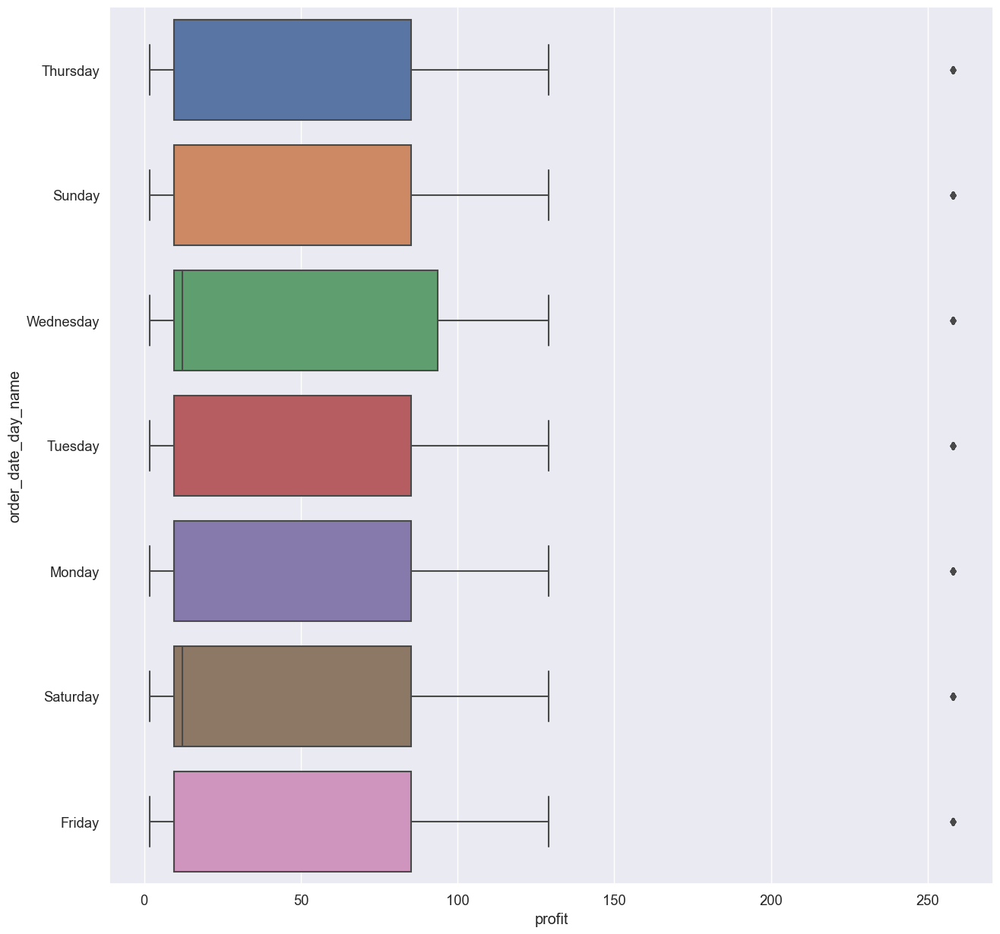

In [161]:
sns.set(rc={'figure.figsize': [15, 15]}, font_scale=1.2)
sns.boxplot(data=df_profit,y='order_date_day_name',x='profit')

<AxesSubplot:xlabel='profit', ylabel='order_date_day_name'>

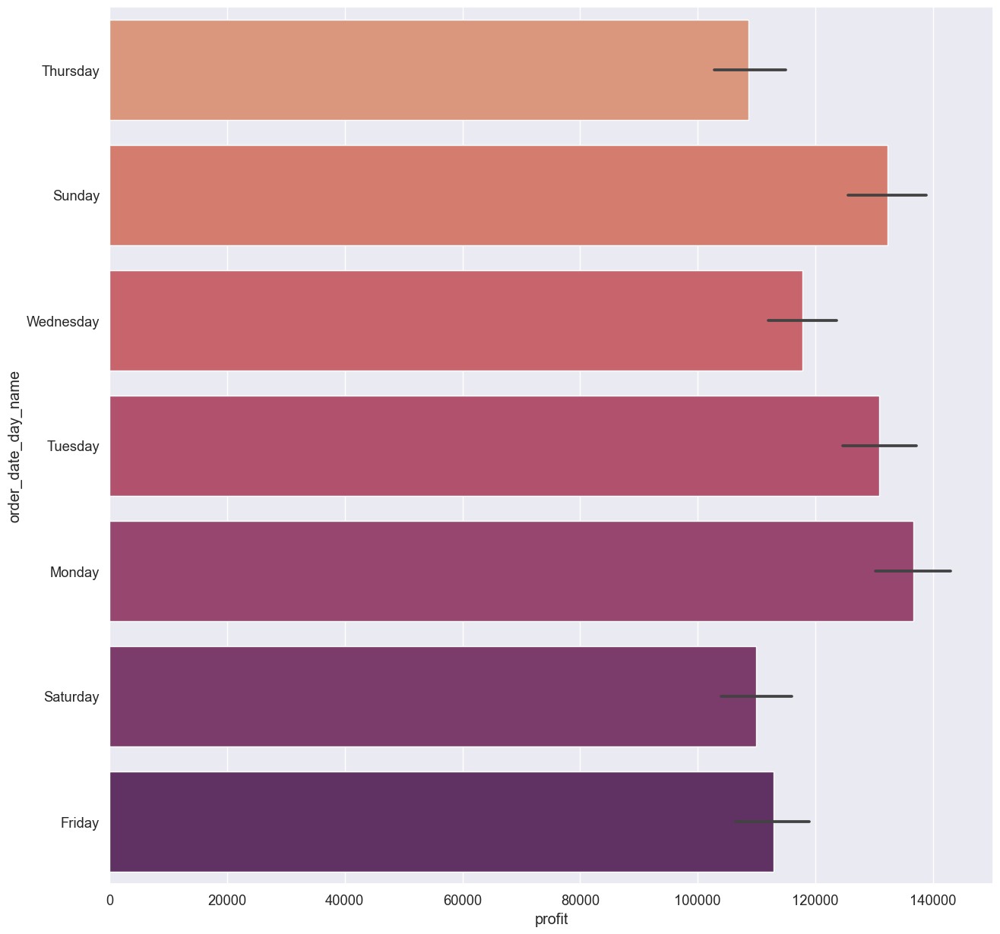

In [167]:
sns.barplot(data=df_profit,y='order_date_day_name',x='profit',estimator=np.sum,palette='flare')

In [169]:
#order data frame depends on profit
df.sort_values('profit', ascending=False)

,order_id,product,quantity_ordered,price_each,order_date,purchase_address,order_date_year,order_date_month,order_date_day,order_date_day_name,order_date_hour,order_date_minute,profit,city
5392,300795,Flatscreen TV,1,300,2019-12-19 05:21:00,"440 River St, Austin, TX 73301",2019,12,19,Thursday,5,21,258.00,Austin
17123,312029,Flatscreen TV,1,300,2019-12-04 08:13:00,"118 4th St, San Francisco, CA 94016",2019,12,4,Wednesday,8,13,258.00,San Francisco
20921,315652,Flatscreen TV,1,300,2019-12-26 12:49:00,"880 Church St, Austin, TX 73301",2019,12,26,Thursday,12,49,258.00,Austin
18449,313286,Flatscreen TV,1,300,2019-12-04 17:01:00,"526 Dogwood St, Boston, MA 02215",2019,12,4,Wednesday,17,1,258.00,Boston
1188,296797,Flatscreen TV,1,300,2019-12-14 11:01:00,"80 1st St, New York City, NY 10001",2019,12,14,Saturday,11,1,258.00,New York City
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17878,312751,AAA Batteries (4-pack),1,2,2019-12-06 15:34:00,"982 4th St, New York City, NY 10001",2019,12,6,Friday,15,34,1.72,New York City
9033,304278,AAA Batteries (4-pack),1,2,2019-12-28 11:24:00,"753 Pine St, San Francisco, CA 94016",2019,12,28,Saturday,11,24,1.72,San Francisco
6873,302223,AAA Batteries (4-pack),1,2,2019-12-20 08:37:00,"464 11th St, San Francisco, CA 94016",2019,12,20,Friday,8,37,1.72,San Francisco
21821,316509,AAA Batteries (4-pack),1,2,2019-12-05 10:05:00,"91 Sunset St, New York City, NY 10001",2019,12,5,Thursday,10,5,1.72,New York City


,order_id,product,quantity_ordered,price_each,order_date,purchase_address,order_date_year,order_date_month,order_date_day,order_date_day_name,order_date_hour,order_date_minute,profit,city
